# Detecting floating plastic using Sentinel-2

Optical satellites offer a unique perspective from which to observe the problem of plastic litter in the marine environment, and some studies have successfully demonstrated their use for this purpose. In this notebook we show how to detect patches of floating macroplastics in optical data acquired by the Sentinel-2 satellite.<br>
The influx of plastic litter is common in the Mediterranean Sea, as already introduced by [1](#Liub), [3](#Biermann1) and [5](#AR). In particular on 10th September 2018, a video emerged on Twitter showed a large amount of plastic garbage in the Beirut River, making Beirut and its coastline a potential target to focus on when searching for examples of litter entering the Mediterranean sea.

You can choose to work with local files or using the Advanced API. Functions in this tutorial can manage both choices independently and automatically, but only if product of interest are provided (as a list or a file). <br> 
Please note that products used in this example notebook could be *offline*: use the `order` function in the `qm` module to retrieve them first.
### Using the Advanced API (ENS)
The input list must contain the position of products in the remote file system. Note that this list is automatically provided using the `SEARCH.ipynb` trial notebook, aimed at facilitating the data access via ENS. Products are found via ENS at their pseudopath, accessed and processed in situ, without any local download. <br>
### Using OData API
Load a custom list containing the products downloaded in the `local_files` folder. To do that, use the `download` function in the `qm` module, which will download and save items via your own Jupyter Notebook using OData protocol. Check out `DISCOVER_ONDA.ipynb` for more details. <br>
Downloads are stored in the 📁`local_files` folder. The 📄`list_local.txt` file will be created and updated in this working directory with the new downloaded item, authomatically.

In [1]:
import os, sys
sys.path.append(os.path.join(os.path.expanduser("~"),"CLEOPE/Trials/modules"))
import data_processing_S2_affine as dp 
import hvplot.xarray

In [2]:
file = dp.product("tiles_T36SYC.txt") # load your custom product list 

👇 Note that this notebook is organised in sections. Each section can be run separately after a kernel restart (i.e. refreshing RAM). Remember to import all the needed modules and files at each restart!

### 1. NDWI computation over an area of interest

To monitor changes related to water content and thus trying to detect litter, we use green and NIR bands, combined into the _Normalised Difference Water Index_, as defined in McFeeters (1996):

\begin{equation}
\text{NDWI}=\frac{R_g-R_{nir}}{R_g-R_{nir}}
\end{equation}

With this purpose, the Sentinel-2 MSI band are:

|MSI band|Descriptor|Central wavelength|Resolution|
|--------|----------|------------------|----------|
|Band 3|G|560 nm|10m|
|Band 8|NIR|833 nm|10m|

#### Affine transformation into geo-coordinates

Sentinel-2 `.jp2` data are already geo-referenced but projection is not suitable for a (_lat_,_lon_) clip as it is. The following line provides reprojection over bands specified as input argument.

In [3]:
xr_ndwi = dp.reproject(bands=dp.ndwi_bands(file[0])) # affine reprojection of coordinates

Now we can take a clip by (_lat_,_lon_) coordinates, specifying the input tuple of coordinates as (_xmin_,_xmax_,_ymin_,_ymax_).

In [4]:
xmin,xmax,ymin,ymax = (35.415,35.6,33.820,34.0) # take a clip of the dataset specifying input coordinates
xr_ndwi_clip = dp.clip(xr_ndwi,(xmin,xmax,ymin,ymax),plot=False)

In [5]:
ndwi = dp.ratio(xr_ndwi_clip) # compute ndwi over the reprojected datasets 

In [6]:
dt = dp.dates(file)
im0 = ndwi.hvplot.quadmesh(x='x',y='y',cmap='spectral',rasterize=True,dynamic=True, aspect='equal',clabel='NDWI',title=dt[0])
display(im0) # visualise results

:DynamicMap   []
   :Image   [x,y]   (value)

👉 Please **Restart** to proceed with this notebook on *CLEOPE Free Account*.

### 2. Photometric analysis

Using the green and NIR spectral bands the potential plastic litter spots/filaments appear enhanced in the image. Water surrounding Beirut shows in particular two prominent possible plastic trails, appearing brighter on the northen and western portion of the clip. We can focus on these smaller areas by taking the other 10m-resolution bands to detect the complete spectral signature of plastic.

|MSI band|Descriptor|Central wavelength|Resolution|
|--------|----------|------------------|----------|
|Band 2|B|490 nm|10m|
|Band 3|G|560 nm|10m|
|Band 4|R|665 nm|10m|
|Band 8|NIR|833 nm|10m|

In [1]:
import os, sys
sys.path.append(os.path.join(os.path.expanduser("~"),"CLEOPE/Trials/modules"))
import data_processing_S2_affine as dp 
import hvplot.xarray

file = dp.product("tiles_T36SYC.txt") # load your custom product list 

In [2]:
bands = dp.bands(file[0])[1:5] # search for all bands at 10m resolution and save only indexes 1:5
# print('\n\n'.join(bands))
n = len(bands)
bnames = {0:'B',1:'G',2:'R',3:'NIR'} # dict to label plots
reproj_bands = dp.reproject(bands) # affine reprojection of geo-coordinates

Zoom-in the clips defininig the _bounds_ argument of `clip` function as (_xmin_,_xmax_,_ymin_,_ymax_), per each band:

In [3]:
# define a list of bounds for the northen and western areas selected as candidates
inserts = [(35.48,35.57,33.92,33.96),(35.43,35.47,33.86,33.908)]
i_clips = [dp.clip(reproj_bands,bounds,plot=False) for bounds in inserts] # clip the image again

In [4]:
del reproj_bands
im_North = [i_clips[0].isel(channel=i).hvplot.quadmesh(x='x',y='y',cmap='cividis',rasterize=True,aspect='equal',colorbar=False,title=bnames[i]) for i in range(n)]
(im_North[0]+im_North[1]+im_North[2]+im_North[3]).cols(1)

:Layout
   .DynamicMap.I   :DynamicMap   []
      :Image   [x,y]   (value)
   .DynamicMap.II  :DynamicMap   []
      :Image   [x,y]   (value)
   .DynamicMap.III :DynamicMap   []
      :Image   [x,y]   (value)
   .DynamicMap.IV  :DynamicMap   []
      :Image   [x,y]   (value)

In [5]:
im_West = [i_clips[1].isel(channel=i).hvplot.quadmesh(x='x',y='y',cmap='cividis',rasterize=True,aspect='equal',colorbar=False,title=bnames[i]) for i in range(n)]
(im_West[0]+im_West[1]+im_West[2]+im_West[3]).cols(2)

:Layout
   .DynamicMap.I   :DynamicMap   []
      :Image   [x,y]   (value)
   .DynamicMap.II  :DynamicMap   []
      :Image   [x,y]   (value)
   .DynamicMap.III :DynamicMap   []
      :Image   [x,y]   (value)
   .DynamicMap.IV  :DynamicMap   []
      :Image   [x,y]   (value)

Definitely the NIR band seems the best candidate to detect reflectance bright spots, in accordance with the literature.

### Average reflectance computation on bright spots
Let's focus only on the bright pixels. See in the plot below the patches (<font color="red">red</font>) we selected to analyse as plastic litter candidates; patches of sorrounding water (<font color="magenta">magenta</font>) are taken, accordingly, per each clip, in order to perform a brightness comparison.

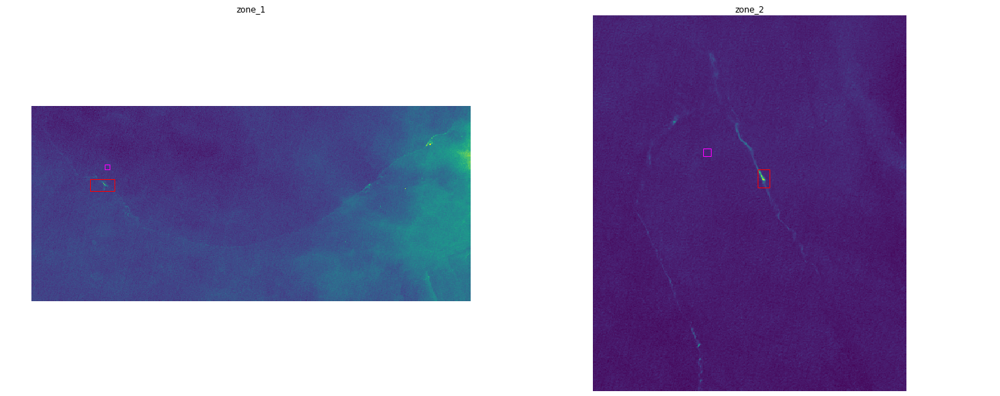

In [6]:
import matplotlib.pyplot as plt
import matplotlib
import numpy as np

labels = [['zone_1','water_1'],['zone_2','water_2']]
# plastic litter candidates
rect = [matplotlib.patches.Rectangle((35.492,33.9425),0.005,0.0025, edgecolor='r', facecolor="none"),
        matplotlib.patches.Rectangle((35.451,33.886),0.0015,0.0023, edgecolor='r', facecolor="none")]
# sorrounding water areas
rect_w = [matplotlib.patches.Rectangle((35.495,33.947),0.001,0.001, edgecolor='magenta', facecolor="none"),
        matplotlib.patches.Rectangle((35.444,33.890),0.001,0.001, edgecolor='magenta', facecolor="none")]

fig, ax = plt.subplots(1,2,figsize=(20,8))
for i,r in enumerate(rect):
    i_clips[i].isel(channel=2).plot(ax=ax[i],add_colorbar=False,add_labels=False) # NIR band is channel=2
    ax[i].add_patch(r)
    ax[i].add_patch(rect_w[i])
    ax[i].set(title=labels[i][0])
    ax[i].axis('equal'); ax[i].axis('off')
fig.tight_layout()

Clip the dataset on the patches shown above.

In [7]:
bands = dp.bands(file[0])[1:5] # search for all bands at 10m resolution and save only indexes 1:5
# print('\n\n'.join(bands))
n = len(bands)
bnames = {0:'B',1:'G',2:'R',3:'NIR'} # dict to label plots
reproj_bands = dp.reproject(bands) # affine reprojection of geo-coordinates

In [8]:
zones = [(35.492,35.497,33.9425,33.945),(35.451,35.4525,33.886,33.8883)]
water = [(35.495,35.496,33.947,33.948),(35.444,35.445,33.890,33.891)]
B_clips = [dp.clip(reproj_bands,z,plot=False) for z in zones]
W_clips = [dp.clip(reproj_bands,w,plot=False) for w in water]
del reproj_bands

Create a `pandas` dataframe containing the average values of pixels over the areas. <br>Sentinel-2 _MSI L2A_ products already provide BOA reflectance; here below DataArray values are divided by 10000 to obtain dimensionless (_dl_) quantities.

In [9]:
import pandas as pd
import seaborn as sns
import numpy as np

sns.set_style("whitegrid")
n = len(bands)
labels = [['zone_1','water_1'],['zone_2','water_2']]
bands_name = [bnames[i] for i in range(n)]
wavelengths = [490.,560.,665.,842]
ds = []
for j in range(2): # 2 macro areas detected (north-west & west)
    dataframe = pd.DataFrame(0,columns=['Reflectance_dl','lambda','band','AOI'],index=range(n*2))
    dataframe.iloc[0:n,1],dataframe.iloc[n:,1] = wavelengths,wavelengths
    dataframe.iloc[0:n,2],dataframe.iloc[n:,2] = bands_name,bands_name
    dataframe.iloc[0:n,-1] = labels[j][0]
    dataframe.iloc[n:,-1] = labels[j][1]
    for i in range(n): # n bands to compute dimensionless avg 
        dataframe.iloc[i,0] = B_clips[j].isel(channel=i).data.mean()/10000
        dataframe.iloc[i+n,0] = W_clips[j].isel(channel=i).data.mean()/10000
    ds.append(dataframe)
final_ds = pd.concat(ds,keys=['NW','W'],names=['Series', 'Rows'])
display(final_ds)

Reflectance_dl  lambda band      AOI
Series Rows                                      
NW     0           0.035208   490.0    B   zone_1
       1           0.028050   560.0    G   zone_1
       2           0.020485   665.0    R   zone_1
       3           0.017503   842.0  NIR   zone_1
       4           0.032945   490.0    B  water_1
       5           0.025764   560.0    G  water_1
       6           0.018784   665.0    R  water_1
       7           0.015974   842.0  NIR  water_1
W      0           0.040371   490.0    B   zone_2
       1           0.031873   560.0    G   zone_2
       2           0.026298   665.0    R   zone_2
       3           0.023775   842.0  NIR   zone_2
       4           0.036963   490.0    B  water_2
       5           0.027806   560.0    G  water_2
       6           0.020924   665.0    R  water_2
       7           0.017398   842.0  NIR  water_2

Visualise the dataframe in a categorical plot. The average band reflectance comparison shows similar proportions of the observed bands present across each zone. This similarity between the two litter regions suggests that probably they are both composed of the same material, with small variations in the reflectance values accounted for by the volume and distribution on the surface.

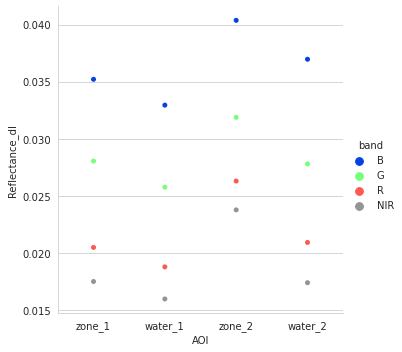

In [10]:
colors = ["blue", "lightgreen", "coral", "grey"]
g = sns.catplot(x='AOI',y='Reflectance_dl',hue='band',data=final_ds,jitter=False,palette=sns.xkcd_palette(colors))

# 📑 References

1. Liubartseva, S., Prevenious, M., Zeri, C., Tsangaris, C., Fakiris, E., Papatheodorou, G., 2018, _Beach Litter dynamics on Mediterranean coasts: Distinguishing sources and pathways_, Vol 129, Issue 2, 448-457.<a id="Liub"></a>
2. _severe-weather.EU_,(@severeweatherEU), Major floods reported in Lebanon, including this unbelievable video of a garbage tsunami/torrent of Basura river in Beirut. Report via Alerta Roj. 10th Sept 2018, 2.57pm. (Tweet)
3. Biermann, Lauren; Martinez Vincente, Victor; Sailley, Sevrine; Mata, Aser; Steele, Christopher, 2019, _Towards a method for detecting macroplastics by satellite: examining Sentinel-2 earth observation data for floating debris in the coastal zone_, EGUGA, 17469.<a id="Biermann1"></a>
4. Biermann, Lauren, Clewley, Daniel, Martinez Vincente, Victor, Topouzelis, Konstantinos, 2020, _Finding plastic patches in coastal Waters using optical Satellite Data_, Scientific Reports Vol 10, 5364.
5. [ARGANS](https://argans.co.uk/) Marine Litter from Space Project. <a id="AR"></a>
6. [NDWI definition on Wikipedia](https://en.wikipedia.org/wiki/Normalized_difference_water_index)